In [ ]:
if 'google.colab' in str(get_ipython()):
    print('Running on CoLab')

    from google.colab import drive
    drive.mount('/content/drive')   

    !pip install geopandas

    import os
    os.chdir('/content/drive/My Drive/Deep_learning_project/')

    city_file = 'Roads/roads.shp'
else:
    print('Not running on CoLab')
    cite_file = 'trimmed_area/shape/roads.shp'

Running on CoLab
Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib  import cm
from matplotlib.colors import LogNorm
import matplotlib.patches as patches
import torch
import torch.nn as nn
from torch.distributions import Normal
from torch.utils.data import TensorDataset, DataLoader
from torch.optim import lr_scheduler
import pickle
import datetime

import geopandas as gpd
from sklearn.mixture import GaussianMixture
from sklearn.model_selection import GridSearchCV

from modules import *

In [ ]:
df = pd.read_csv('GM_preparedData.csv')

In [ ]:
def format_tripStart(x, **kwargs):
    if hasattr(x, 'hour'):
        hour = x.hour * 60 * 60
        minute = x.minute * 60
        time_seconds = hour + minute
    else:
        x = datetime.timedelta(hours=x)
        time_seconds = x.seconds

    encoded_time = kwargs['encoder'](2 * np.pi * time_seconds / (24 * 60 * 60))
    
    return encoded_time

def format_time_split_hours(x):
    
    return int(x.hour)

In [ ]:
# Define rectangle where "valid data belongs":
upper_right = (55.8, 12.707644)
lower_left = (55.548626, 12.061736)

# Clean data
df_clean = df.loc[(df['startPositionLat'] >= lower_left[0]) & (df['startPositionLat']<=upper_right[0])]
df_clean = df_clean.loc[(df_clean['startPositionLng'] >= lower_left[1]) & (df_clean['startPositionLng']<=upper_right[1])]

df_clean = df_clean.loc[(df_clean['endPositionLat'] >= lower_left[0]) & (df_clean['endPositionLat']<=upper_right[0])]
df_clean = df_clean.loc[(df_clean['endPositionLng'] >= lower_left[1]) & (df_clean['endPositionLng']<=upper_right[1])]

df_clean = df_clean.dropna(
    axis=0, 
    subset=['startPositionLat', 'startPositionLng', 'endPositionLat', 'endPositionLng', 'tripStart']
)

df_clean['tripStart'] = pd.to_datetime(df_clean['tripStart'], format='%d%b%y:%H:%M:%S')
df_clean['cos_timeOfDay'] = df_clean['tripStart'].apply(format_tripStart, encoder=np.cos)
df_clean['sin_timeOfDay'] = df_clean['tripStart'].apply(format_tripStart, encoder=np.sin)

df_clean['timeHour'] = df_clean['tripStart'].apply(format_time_split_hours)

In [ ]:
city_map = gpd.read_file(city_file)

bounds_df = city_map['geometry'].bounds
maxx = bounds_df['maxx'].max()
minx = bounds_df['minx'].min()
maxy = bounds_df['maxy'].max()
miny = bounds_df['miny'].min()

In [ ]:
#Normalize data
mu_lat_start = df_clean['startPositionLat'].mean()
sig_lat_start = df_clean['startPositionLat'].std()

mu_lng_start = df_clean['startPositionLng'].mean()
sig_lng_start = df_clean['startPositionLng'].std()

df_clean['NormLatStart'] = df_clean['startPositionLat'].apply(lambda x: (x-mu_lat_start)/sig_lat_start)
df_clean['NormLngStart'] = df_clean['startPositionLng'].apply(lambda x: (x-mu_lng_start)/sig_lng_start)

mu_lat_end = df_clean['endPositionLat'].mean()
sig_lat_end = df_clean['endPositionLat'].std()

mu_lng_end = df_clean['endPositionLng'].mean()
sig_lng_end = df_clean['endPositionLng'].std()

df_clean['NormLngEnd'] = df_clean['endPositionLng'].apply(lambda x: (x-mu_lng_end)/sig_lng_end)
df_clean['NormLatEnd'] = df_clean['endPositionLat'].apply(lambda x: (x-mu_lat_end)/sig_lat_end)


mu_cos = df_clean['cos_timeOfDay'].mean()
sig_cos = df_clean['cos_timeOfDay'].std()

mu_sin = df_clean['sin_timeOfDay'].mean()
sig_sin = df_clean['sin_timeOfDay'].std()

df_clean['Normsin'] = df_clean['sin_timeOfDay'].apply(lambda x: (x-mu_sin)/sig_sin)
df_clean['Normcos'] = df_clean['cos_timeOfDay'].apply(lambda x: (x-mu_cos)/sig_cos)



data_columns = ['NormLatStart', 'NormLngStart', 'NormLatEnd', 'NormLngEnd', 'timeHour','Normsin', 'Normcos', 'startPositionLng', 'startPositionLat']

data = df_clean[data_columns]

In [ ]:
plotting_bounds = (12.45, 12.6, 55.66, 55.75)

In [ ]:
df_plotting_bounds = data.loc[(data['startPositionLng'] >= plotting_bounds[0]) &
                              (data['startPositionLng'] <= plotting_bounds[1]) &
                              (data['startPositionLat'] >= plotting_bounds[2]) &
                              (data['startPositionLat'] <= plotting_bounds[3])]

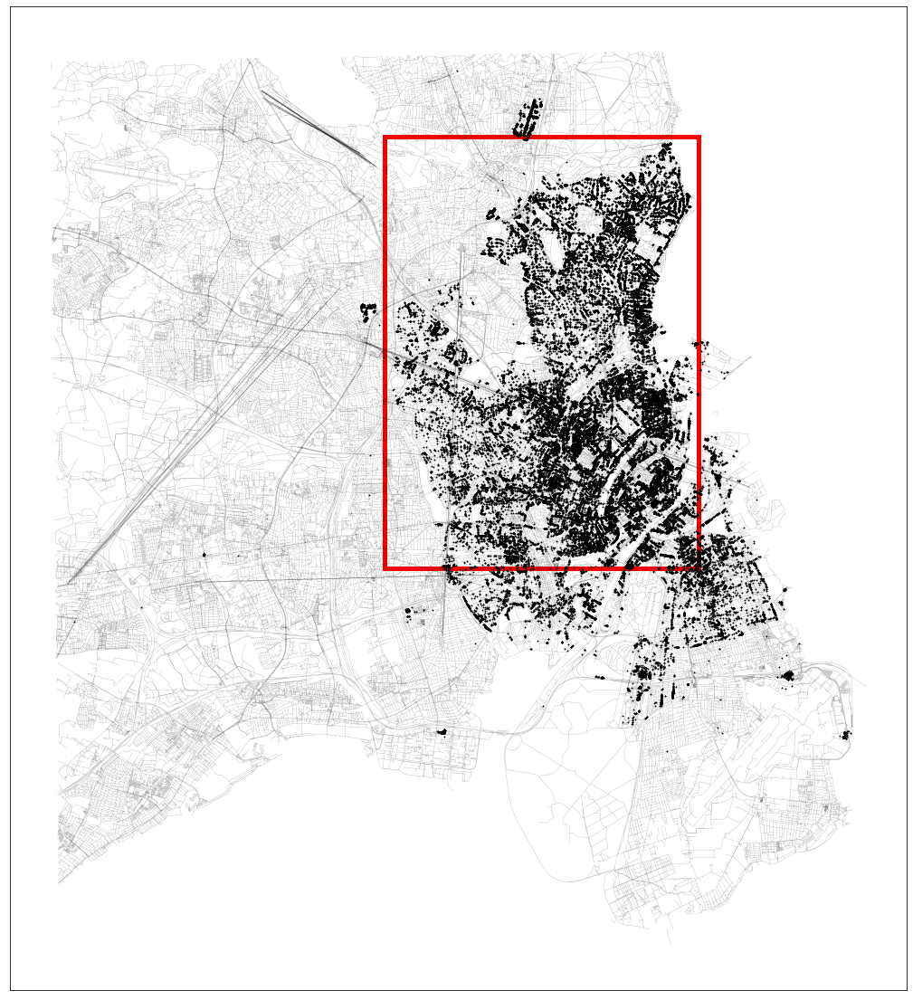

In [ ]:

map_plot = city_map.plot(figsize=(20, 20), edgecolor='black', linewidth=0.1)
x, y = df_clean['startPositionLng'].values, df_clean['startPositionLat'].values
scatter = map_plot.scatter(x, y, marker="*", c='black', alpha=1, zorder=5, s=1)
map_plot.set_title('')
rect = patches.Rectangle((plotting_bounds[0], plotting_bounds[2]), 0.155, 0.12, linewidth=5, edgecolor='r', facecolor='none')
map_plot.add_patch(rect)
map_plot.set_xticks([])
map_plot.set_yticks([])

plt.savefig('POSTER/pickups_cph.png', transparent=True)

# Baseline: Mixed Gaussian Model

In [ ]:
bic_list = []
components_range = range(5, 30)
for components in components_range:
    gmm = GaussianMixture(n_components=components, covariance_type='full', random_state=42)
    gmm.fit(data[['NormLngStart', 'NormLatStart']])
    bic_list.append(gmm.bic(data[['NormLngStart', 'NormLatStart']]))

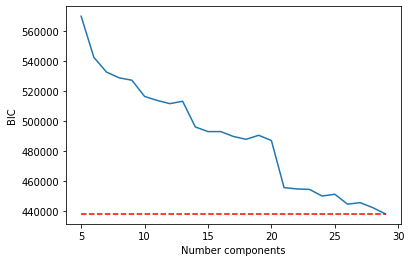

In [ ]:
plt.plot(list(components_range), bic_list)
plt.plot(list(components_range), [min(bic_list)]*len(list(components_range)), c='r', linestyle='dashed' )
plt.xlabel('Number components')
plt.ylabel('BIC')
plt.show()

In [ ]:
gmm = GaussianMixture(n_components=10, covariance_type='full', random_state=42)
gmm.fit(data[['NormLngStart', 'NormLatStart']])

GaussianMixture(covariance_type='full', init_params='kmeans', max_iter=100,
                means_init=None, n_components=10, n_init=1,
                precisions_init=None, random_state=42, reg_covar=1e-06,
                tol=0.001, verbose=0, verbose_interval=10, warm_start=False,
                weights_init=None)

In [ ]:
x_linspace = np.linspace(minx, maxx, num=75)
y_linspace = np.linspace(miny, maxy, num=75)

X, Y = np.meshgrid(x_linspace, y_linspace)
X_stand, Y_stand = (X-mu_lng_start)/sig_lng_start, (Y-mu_lat_start)/sig_lat_start

XX = np.array([X_stand.ravel(), Y_stand.ravel()]).T

Z = -gmm.score_samples(XX)
Z = Z.reshape(X.shape)

# with open('MGM_baseline.pckl', 'wb') as f:
#     pickle.dump(gmm, f)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:12: UserWarning: linewidths is ignored by contourf
  if sys.path[0] == '':


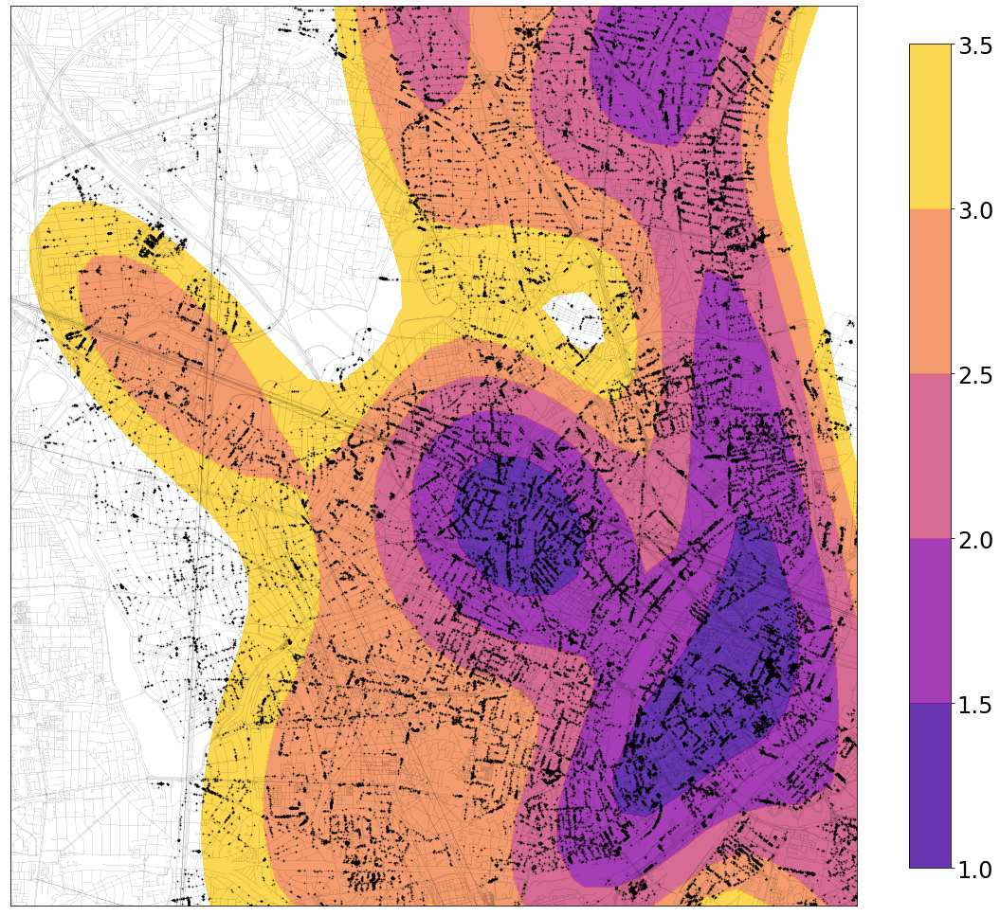

In [ ]:
map_plot = city_map.plot(figsize=(20, 20), edgecolor='black', linewidth=0.1)
x, y = df_clean['startPositionLng'].values, df_clean['startPositionLat'].values
scatter = map_plot.scatter(x, y, marker="*", c='black', alpha=0.7, zorder=5, s=1)
CS = map_plot.contourf(
    X, 
    Y, 
    Z, 
    #norm=LogNorm(vmin=0.010, vmax=10), 
    levels=[1, 1.5, 2, 2.5, 3, 3.5],
    linewidths=5,
    alpha=0.8,
    cmap="plasma"
)
map_plot.set_xlim(plotting_bounds[0], plotting_bounds[1])
map_plot.set_ylim(plotting_bounds[2], plotting_bounds[3])

CB = plt.colorbar(CS, shrink=0.8, extend='both')
CB.ax.tick_params(labelsize=24)
map_plot.set_title('')
map_plot.set_xticks([])
map_plot.set_yticks([])
plt.savefig('POSTER/GMM_zoomed.png', transparent=True, bbox_inches='tight')

## SUM LOG LIKELIHOOD

In [ ]:
-gmm.score_samples(data[['NormLngStart', 'NormLatStart']]).sum()

257881.89476202225

# Vanilla Normalizing Flow


In [ ]:
from modules import RealNVP

In [ ]:
mu = torch.zeros(2)
sigma = torch.ones(2)
base = Normal(mu, sigma)

model = RealNVP(in_features=2, prior=base, hidden_features=256, depth=6)
model.load_state_dict(torch.load('model_state_vanilla_NF_updated_epoch_201.pth', map_location=torch.device('cpu')))

<All keys matched successfully>

### Log-likelihood plot



In [ ]:
X, Y, Z = Z_values(model.log_likelihood, (minx, maxx, miny, maxy), mu_lng_start, sig_lng_start, mu_lat_start, sig_lat_start)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:12: UserWarning: linewidths is ignored by contourf
  if sys.path[0] == '':


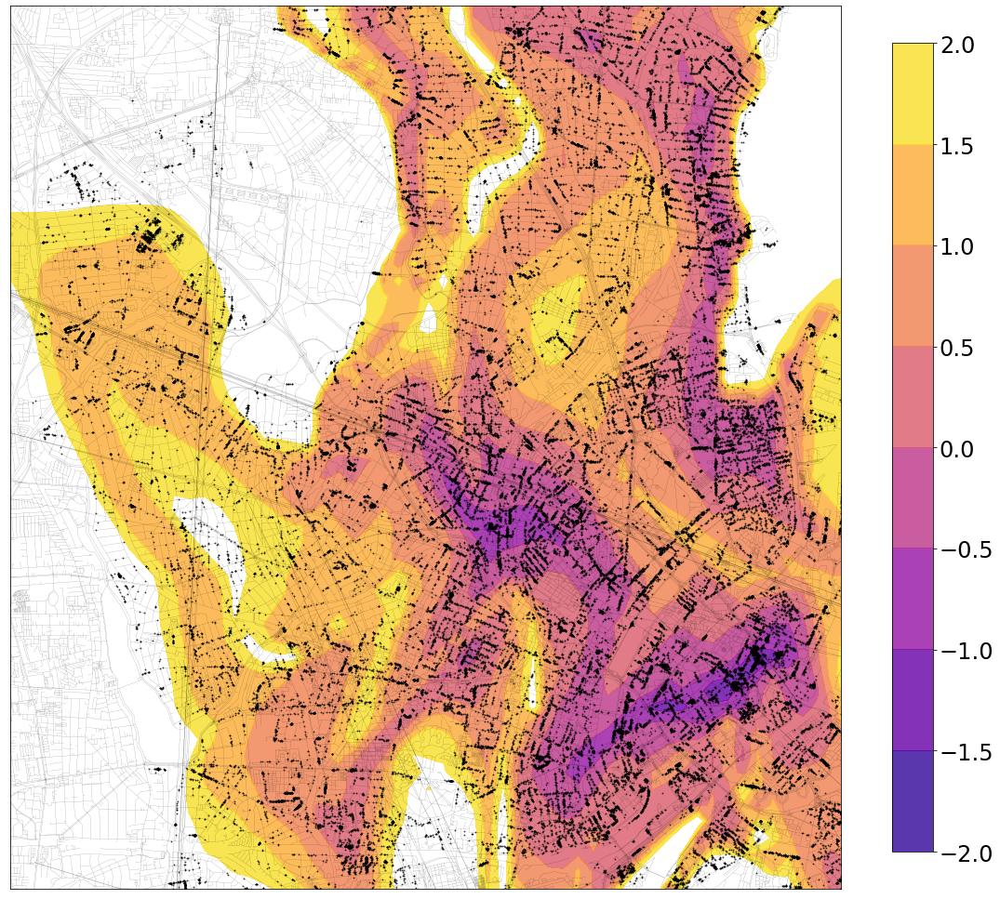

In [ ]:
map_plot = city_map.plot(figsize=(20, 20), edgecolor='black', linewidth=0.1)
x, y = df_clean['startPositionLng'].values, df_clean['startPositionLat'].values
CS = map_plot.contourf(
    X, 
    Y, 
    Z, 
    #norm=LogNorm(vmin=0.010, vmax=10), 
    #levels=np.logspace(-1.5, 0.8, 5),
    levels=[-2, -1.5, -1, -0.5, 0, 0.5, 1, 1.5, 2],
    linewidths=5,
    alpha=0.8,
    cmap="plasma"
)
scatter = map_plot.scatter(x, y, marker="*", c='black', alpha=0.7, zorder=5, s=1)
map_plot.set_xlim(plotting_bounds[0], plotting_bounds[1])
map_plot.set_ylim(plotting_bounds[2], plotting_bounds[3])

CB = plt.colorbar(CS, shrink=0.8, extend='both')
CB.ax.tick_params(labelsize=24)
map_plot.set_title('')
map_plot.set_xticks([])
map_plot.set_yticks([])
plt.savefig('POSTER/vanilla_zoomed.png', transparent=True, bbox_inches='tight')

### Training and Validation loss

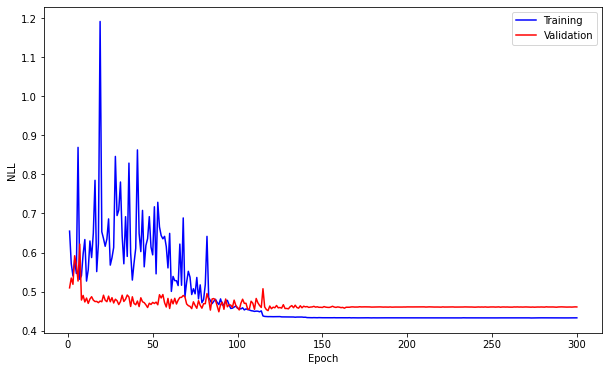

In [ ]:
with open('loss_dict.pkl', 'rb') as f:
    losses = pickle.load(f)

training_loss_VNF = np.array(losses['train'][200:])
validation_loss_VNF = np.array(losses['validation'][200:])
epochs_VNF = np.arange(1,len(training_loss_VNF)+1)

plt.figure(figsize=(10,6))
plt.plot(epochs_VNF, training_loss_VNF, 'b')
plt.plot(epochs_VNF, validation_loss_VNF, 'r')
plt.legend(['Training', 'Validation'])
plt.xlabel('Epoch')
plt.ylabel('NLL')
plt.show()

## SUM LOG LIKELIHOOD

In [ ]:
x_log = torch.Tensor(data[['NormLngStart', 'NormLatStart']].values)

In [ ]:
x, log_det = model.forward(x_log)

In [ ]:
prior_logprob = model.prior.log_prob(x)

In [ ]:
- (prior_logprob.sum() + log_det.sum())

tensor(137328.6875, grad_fn=<NegBackward>)

# Time Condtional Normalizing Flow


In [ ]:
mu = torch.zeros(4).to(device)
sigma = torch.ones(4).to(device)
base = Normal(mu, sigma)

net_time = RealNVP(in_features=4, prior=base, hidden_features=256, depth=6).to(device)

In [ ]:
net_time.load_state_dict(torch.load('model_state_fix_prior_time_cond_updated_epoch_251.pth'))

<All keys matched successfully>

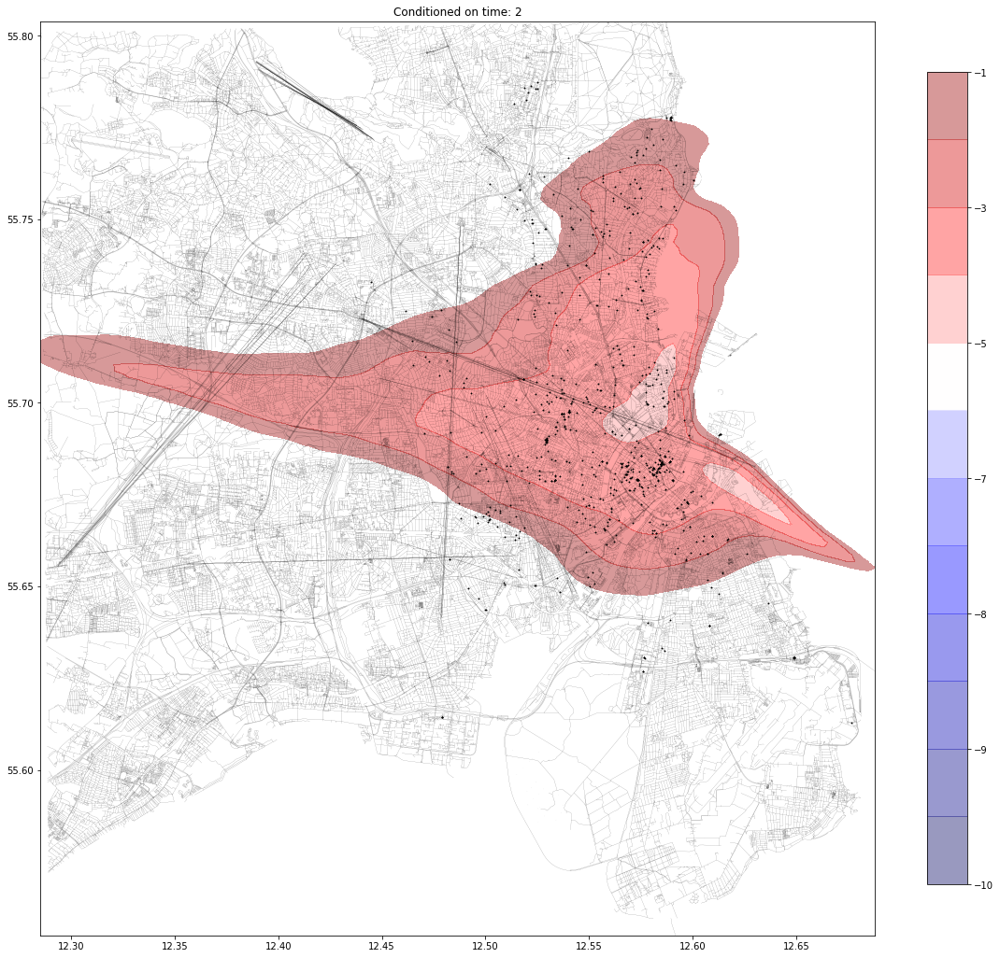

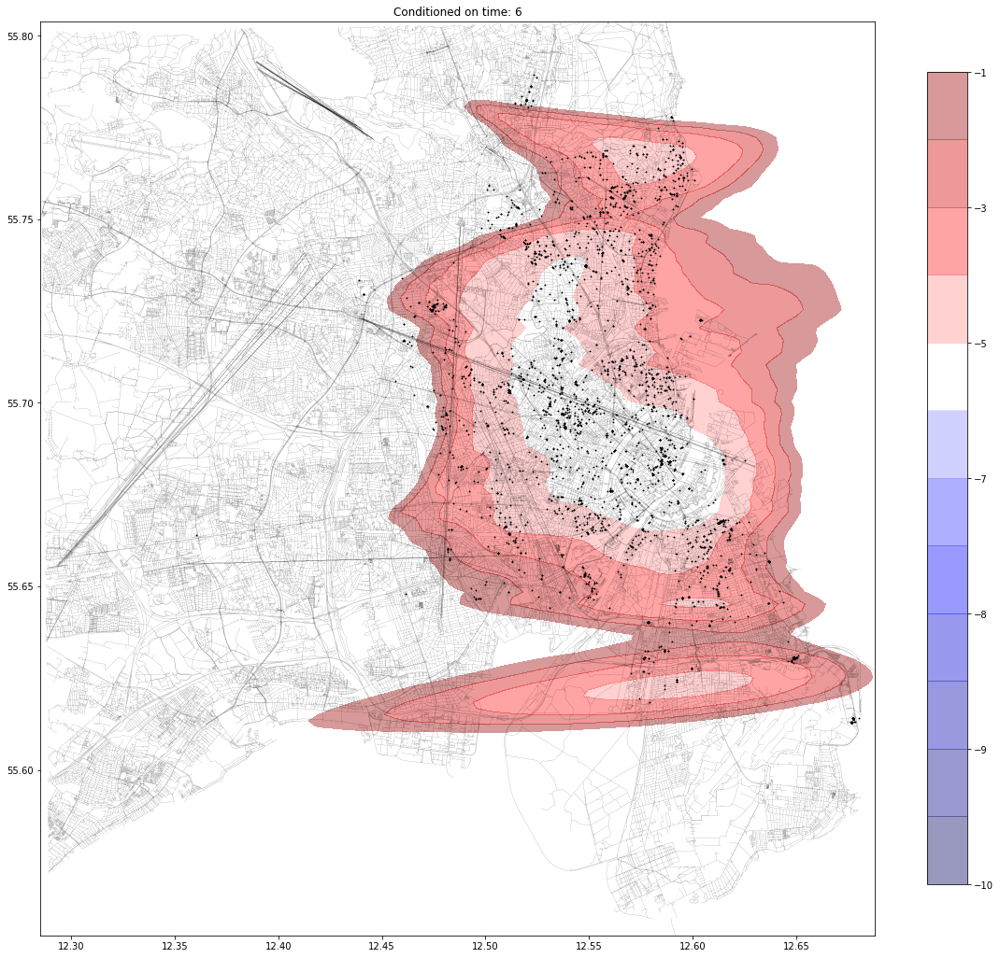

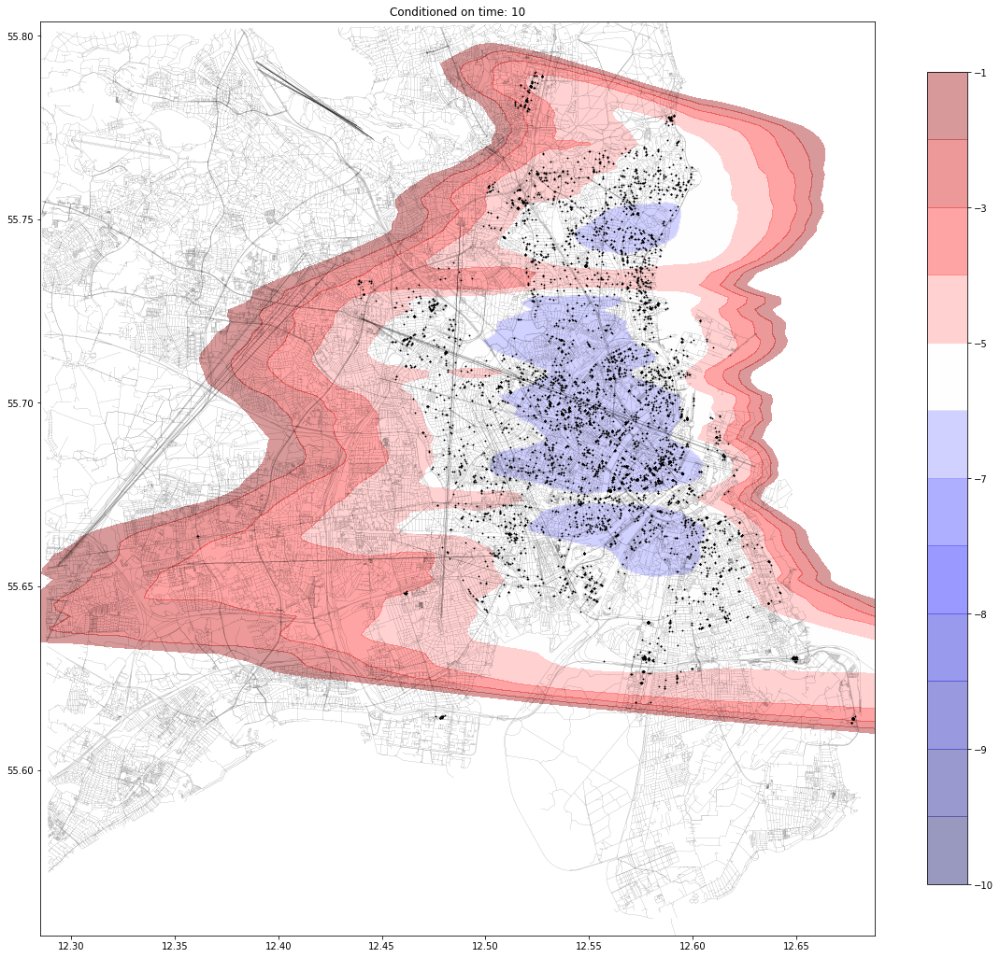

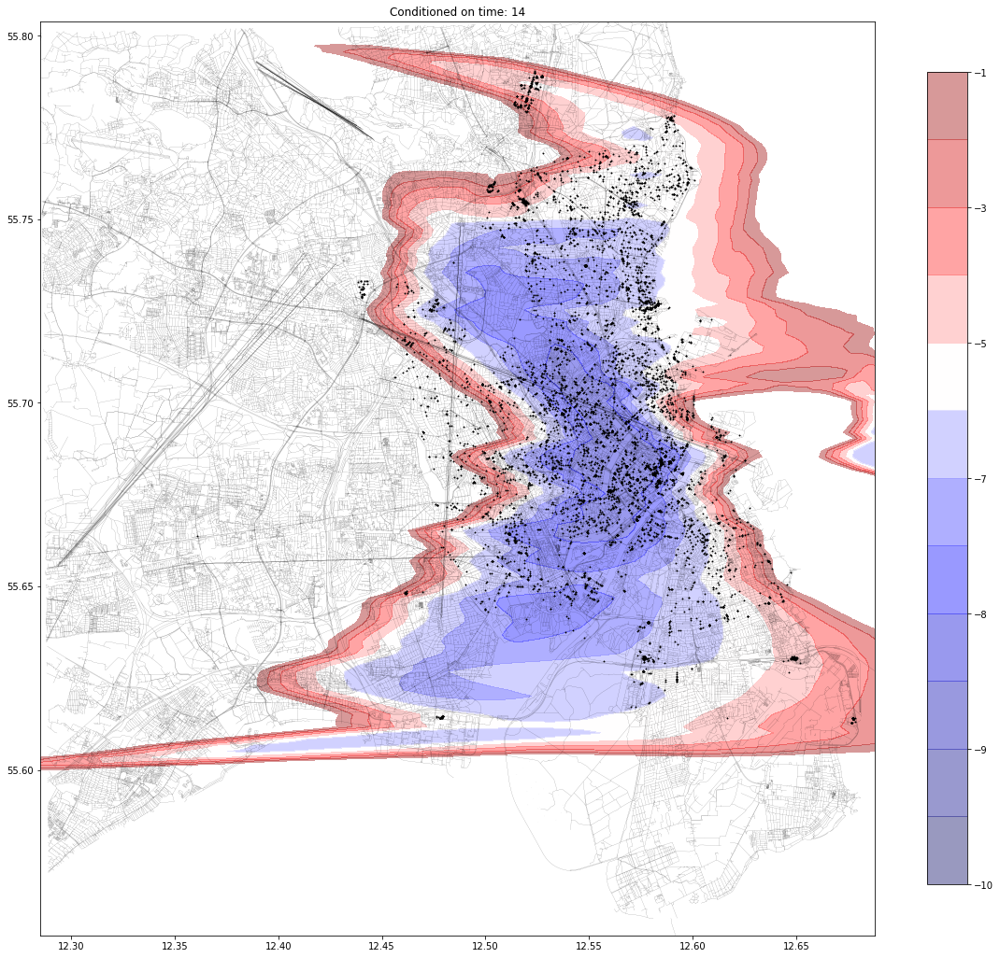

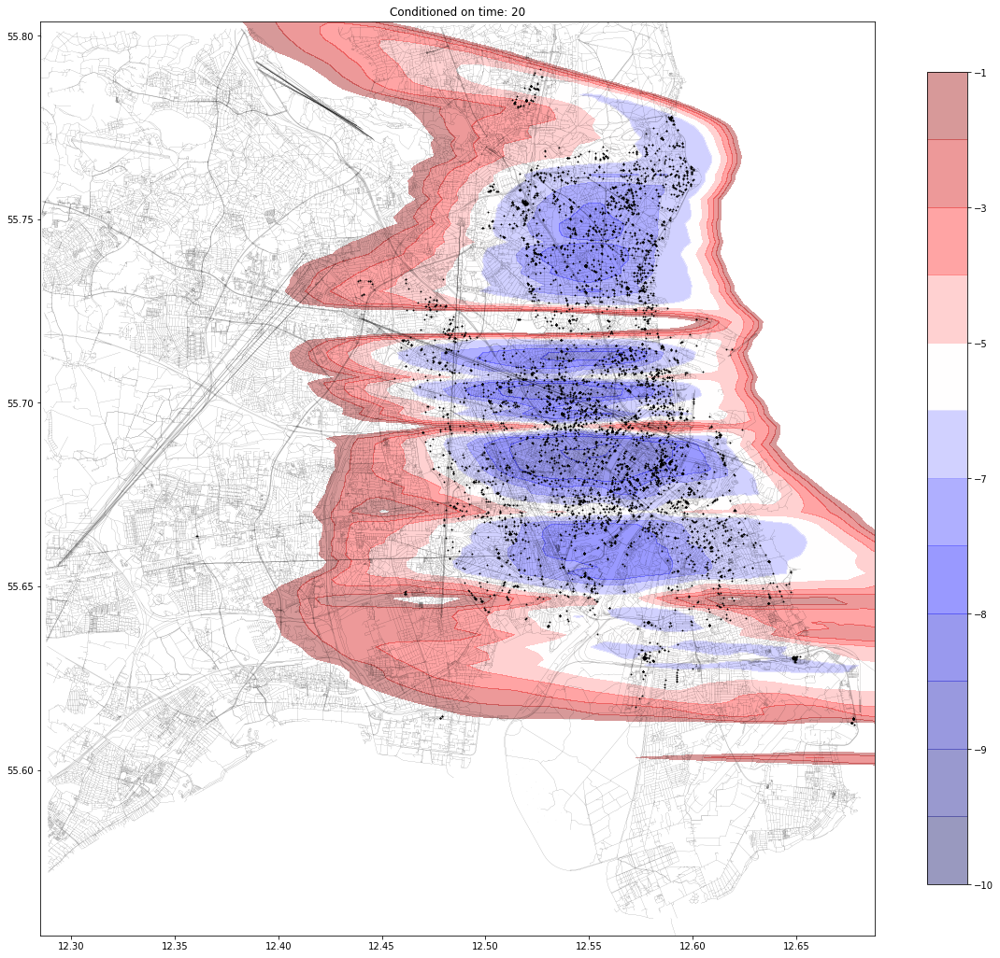

In [ ]:
#net_time.eval()
for time in [2, 6, 10, 14, 20]:
    sin_time = format_tripStart(time, encoder=np.sin)
    cos_time = format_tripStart(time, encoder=np.cos)
    sin_time = (sin_time - mu_sin) / sig_sin
    cos_time = (cos_time - mu_cos) / sig_cos

    cond_time = torch.Tensor([sin_time, cos_time])
    X, Y, Z = Z_values(net_time.log_likelihood, (minx, maxx, miny, maxy), mu_lng_start, sig_lng_start, mu_lat_start, sig_lat_start, cond=cond_time)

    df_sub_time = df_clean.loc[df_clean['timeHour'] == time]

    map_plot = city_map.plot(figsize=(20, 20), edgecolor='black', linewidth=0.1)
    map_plot = contour_plot_map(
        map_plot, 
        X,
        Y,
        Z,
        cmap='seismic',
        levels=[-10, -9.5, -9, -8.5, -8, -7.5, -7, -6, -5, -4, -3, -2, -1],
        alpha=0.4
    )
    x, y = df_sub_time['startPositionLng'].values, df_sub_time['startPositionLat'].values
    scatter = map_plot.scatter(x, y, marker="*", c='black', zorder=5, s=1)
    map_plot.set_title(f'Conditioned on time: {time}')
    plt.show()

In [ ]:
mu = torch.zeros(4).to(device)
sigma = torch.ones(4).to(device)
base = Normal(mu, sigma)

net_time = RealNVP(in_features=4, prior=base, hidden_features=256, depth=10, batchnorm=True).to(device)

In [ ]:
net_time.load_state_dict(torch.load('model_state_fix_prior_cond.pth'))

<All keys matched successfully>

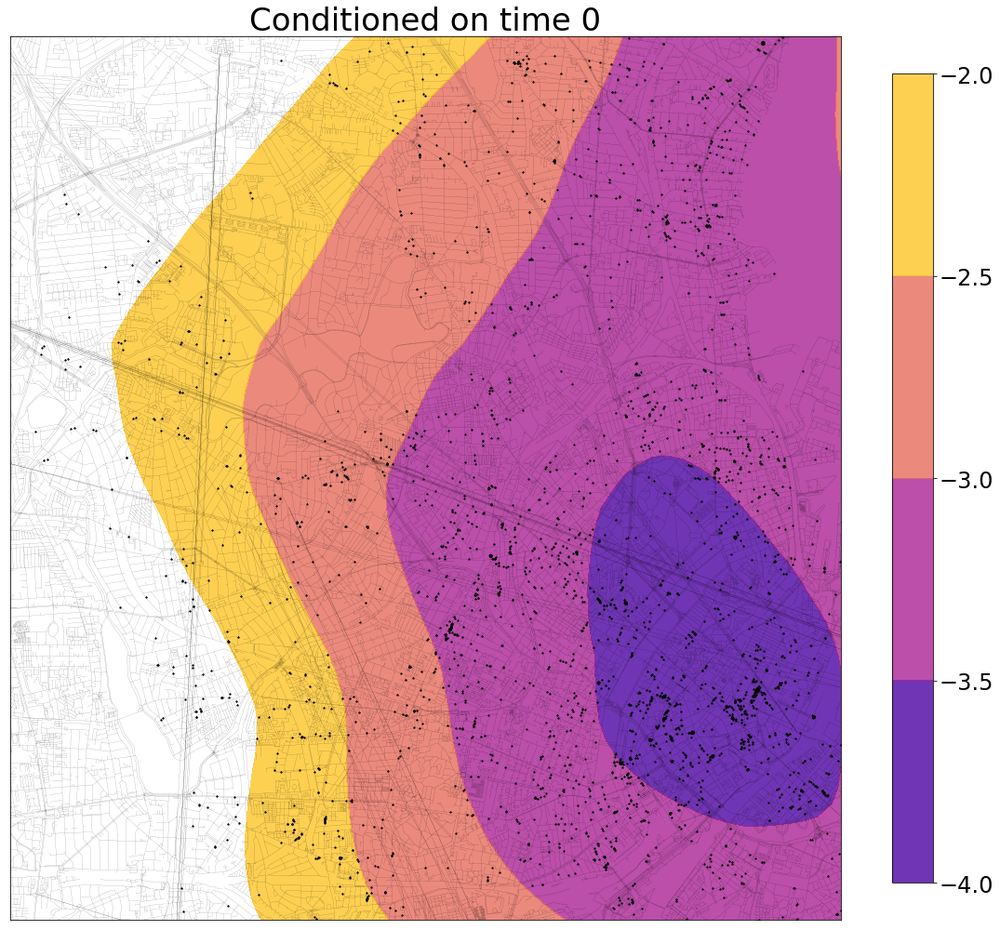

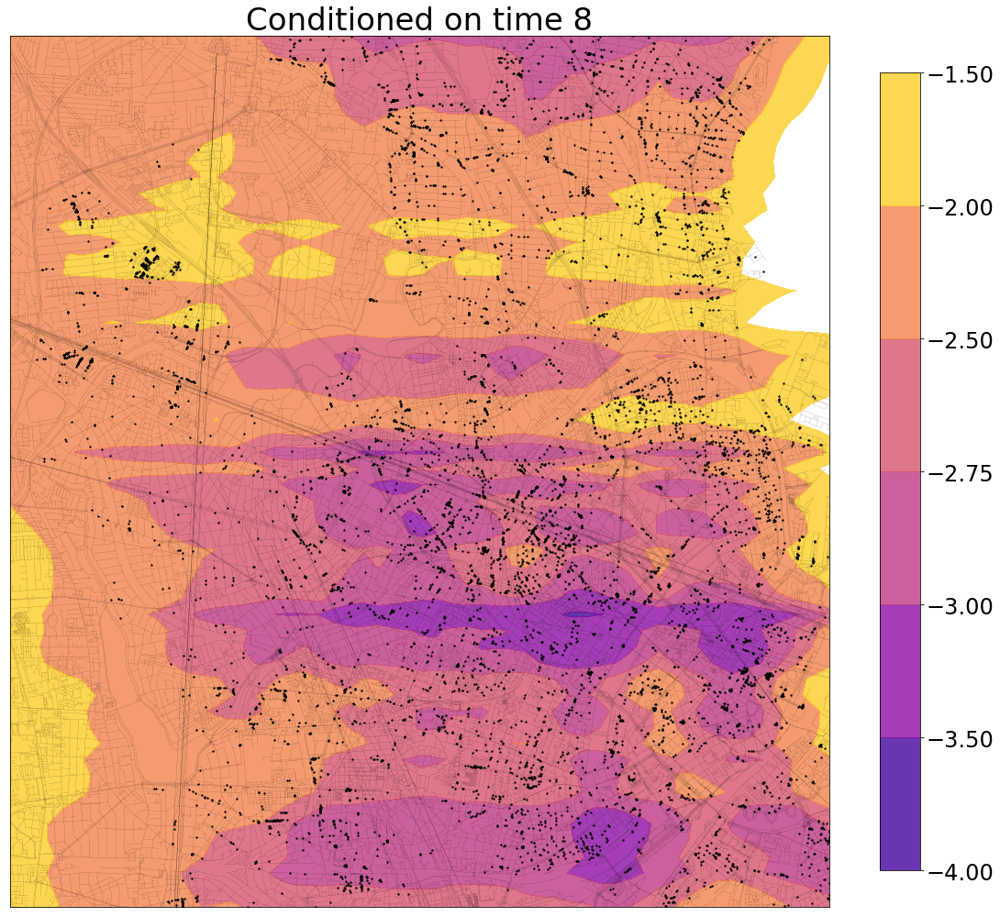

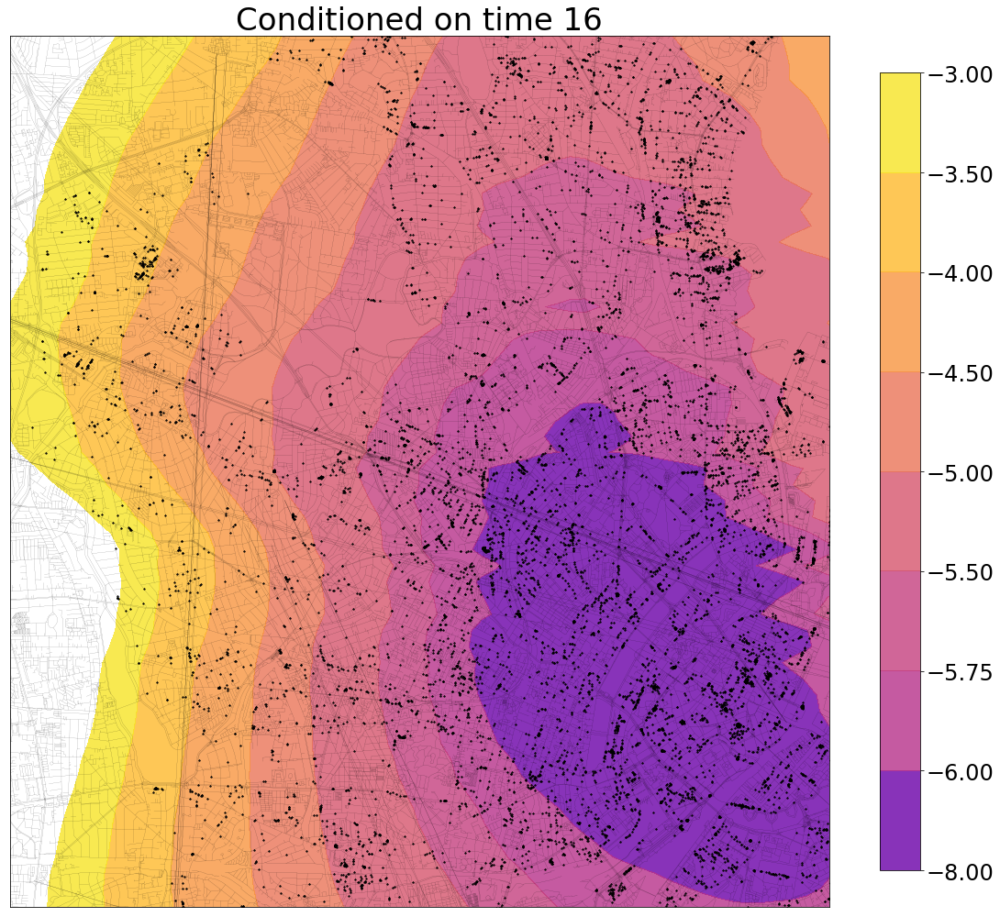

In [ ]:
net_time.eval()
times = [0, 8, 16]
levels = [
    [-4, -3.5, -3, -2.5, -2],
    [-4, -3.5, -3, -2.75, -2.5, -2, -1.5],
    [-8, -6, -5.75, -5.5, -5, -4.5, -4, -3.5, -3],
    [-6, -5.75, -5.5, -5, -4.5, -4for i in range(3):
    time = times[i]
    sin_time = format_tripStart(time, encoder=np.sin)
    cos_time = format_tripStart(time, encoder=np.cos)
    sin_time = (sin_time - mu_sin) / sig_sin
    cos_time = (cos_time - mu_cos) / sig_cos

    cond_time = torch.Tensor([sin_time, cos_time])
    X, Y, Z = Z_values(net_time.log_likelihood, (minx, maxx, miny, maxy), mu_lng_start, sig_lng_start, mu_lat_start, sig_lat_start, cond=cond_time)

    if time == 0:
        df_sub_time = df_clean.loc[(df_clean['timeHour'] == time) | (df_clean['timeHour'] == 23)]
    else:
        df_sub_time = df_clean.loc[(df_clean['timeHour'] == time) | (df_clean['timeHour'] == time-1)]

    map_plot = city_map.plot(figsize=(20, 20), edgecolor='black', linewidth=0.1)

    CS = map_plot.contourf(
        X, 
        Y, 
        Z, 
        cmap='plasma',
        levels=levels[i],
        alpha=0.8,
    )

    x, y = df_sub_time['startPositionLng'].values, df_sub_time['startPositionLat'].values

    scatter = map_plot.scatter(x, y, marker="*", c='black', alpha=0.85, zorder=5, s=2.5)

    map_plot.set_xlim(plotting_bounds[0], plotting_bounds[1])
    map_plot.set_ylim(plotting_bounds[2], plotting_bounds[3])

    CB = plt.colorbar(CS, shrink=0.8, extend='both')
    CB.ax.tick_params(labelsize=24)
    map_plot.set_title('')
    map_plot.set_xticks([])
    map_plot.set_yticks([])
    map_plot.set_title(f'Conditioned on time {str(time)}', fontdict={'size': 34})
    plt.savefig(f'POSTER/time{str(time)}_cond.png', transparent=True, bbox_inches='tight'), -3.5, -3]
]


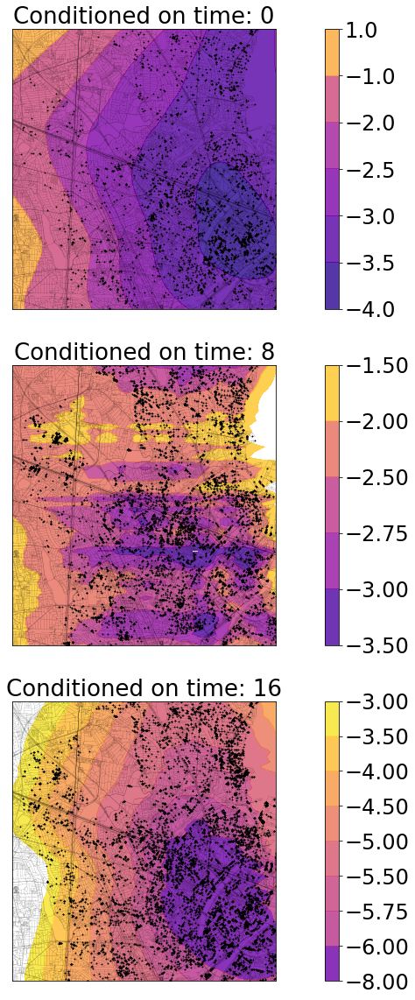

In [ ]:
net_time.eval()

times = [0, 8, 16]
levels = [
    [-4, -3.5, -3, -2.5, -2, -1, 1],
    [-3.5, -3, -2.75, -2.5, -2, -1.5],
    [-8, -6, -5.75, -5.5, -5, -4.5, -4, -3.5, -3],
    [-6, -5.75, -5.5, -5, -4.5, -4, -3.5, -3]
]

fig, axes = plt.subplots(nrows=3, ncols=1, figsize=(20, 20))

for i, ax in enumerate(axes.flat):
    time = times[i]
    sin_time = format_tripStart(time, encoder=np.sin)
    cos_time = format_tripStart(time, encoder=np.cos)
    sin_time = (sin_time - mu_sin) / sig_sin
    cos_time = (cos_time - mu_cos) / sig_cos

    cond_time = torch.Tensor([sin_time, cos_time])
    X, Y, Z = Z_values(net_time.log_likelihood, (minx, maxx, miny, maxy), mu_lng_start, sig_lng_start, mu_lat_start, sig_lat_start, cond=cond_time)

    if time == 0:
        df_sub_time = df_clean.loc[(df_clean['timeHour'] == time) | (df_clean['timeHour'] == 23)]
    else:
        df_sub_time = df_clean.loc[(df_clean['timeHour'] == time) | (df_clean['timeHour'] == time-1)]

    map_plot = city_map.plot(figsize=(20, 20), edgecolor='black', linewidth=0.1, ax=ax)

    #CS = map_plot.contourf(
    CS = ax.contourf(
        X, 
        Y, 
        Z, 
        cmap='plasma',
        levels=levels[i],
        alpha=0.8,
    )
    CB = fig.colorbar(CS, ax=ax)

    CB.ax.tick_params(labelsize=24)
    
    x, y = df_sub_time['startPositionLng'].values, df_sub_time['startPositionLat'].values
    scatter = map_plot.scatter(x, y, marker="*", c='black', zorder=5, s=1)

    ax.set_xticks([])
    ax.set_yticks([])
    
    ax.set_xlim(plotting_bounds[0], plotting_bounds[1])
    ax.set_ylim(plotting_bounds[2], plotting_bounds[3])
    ax.set_title(f'Conditioned on time: {time}', fontdict={'size': 26})
plt.savefig('POSTER/timecond_zoomed.png', transparent=True, bbox_inches='tight')

## LOG PROB

In [ ]:
x_log = torch.Tensor(data[['NormLngStart', 'NormLatStart', 'Normsin', 'Normcos']].values)

In [ ]:
net_time.eval()
x, log_det = net_time.forward(x_log)

In [ ]:
prior_logprob = net_time.prior.log_prob(x)

In [ ]:
-(prior_logprob.sum() + log_det.sum())

tensor(-1939734.5000, grad_fn=<NegBackward>)

# Pick-up Conditional Normalizing Flow

In [ ]:
mu = torch.zeros(4).to(device)
sigma = torch.ones(4).to(device)
base = Normal(mu, sigma)

net_pickup = RealNVP(in_features=4, prior=base, hidden_features=256, depth=6).to(device)

In [ ]:
net_pickup.load_state_dict(torch.load('model_state_pickup_fix_prior_cond.pth'))

<All keys matched successfully>

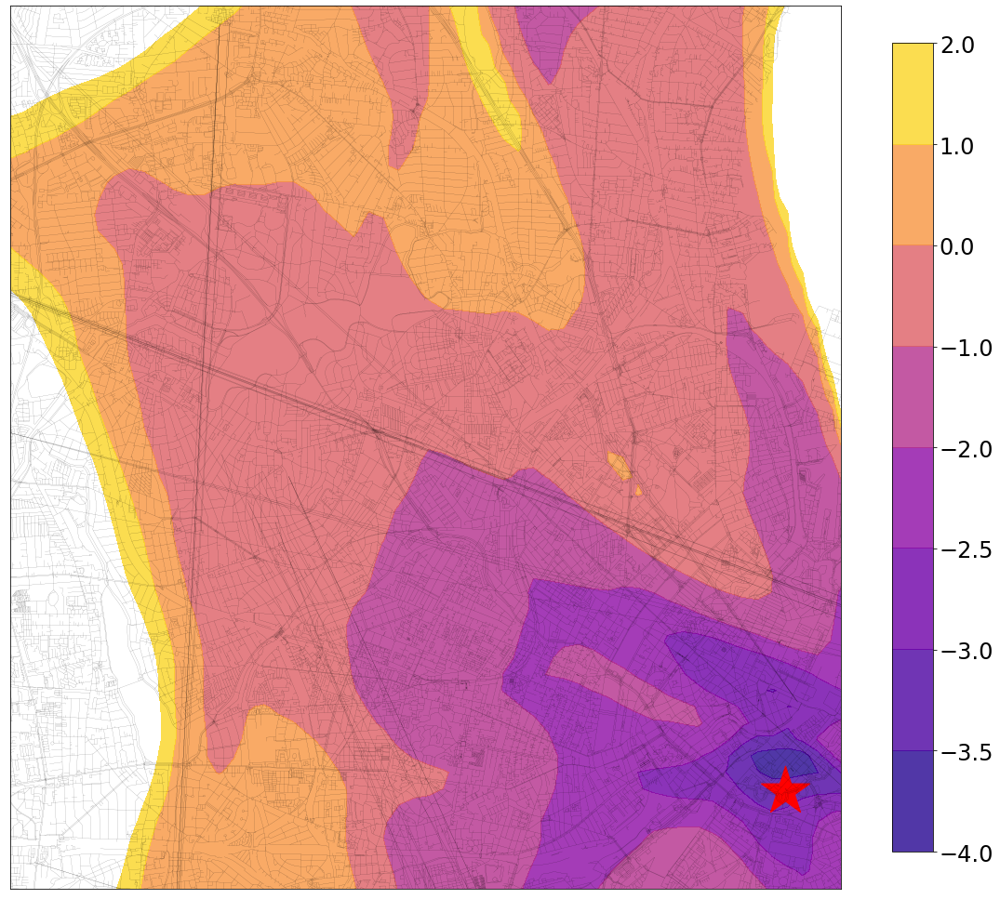

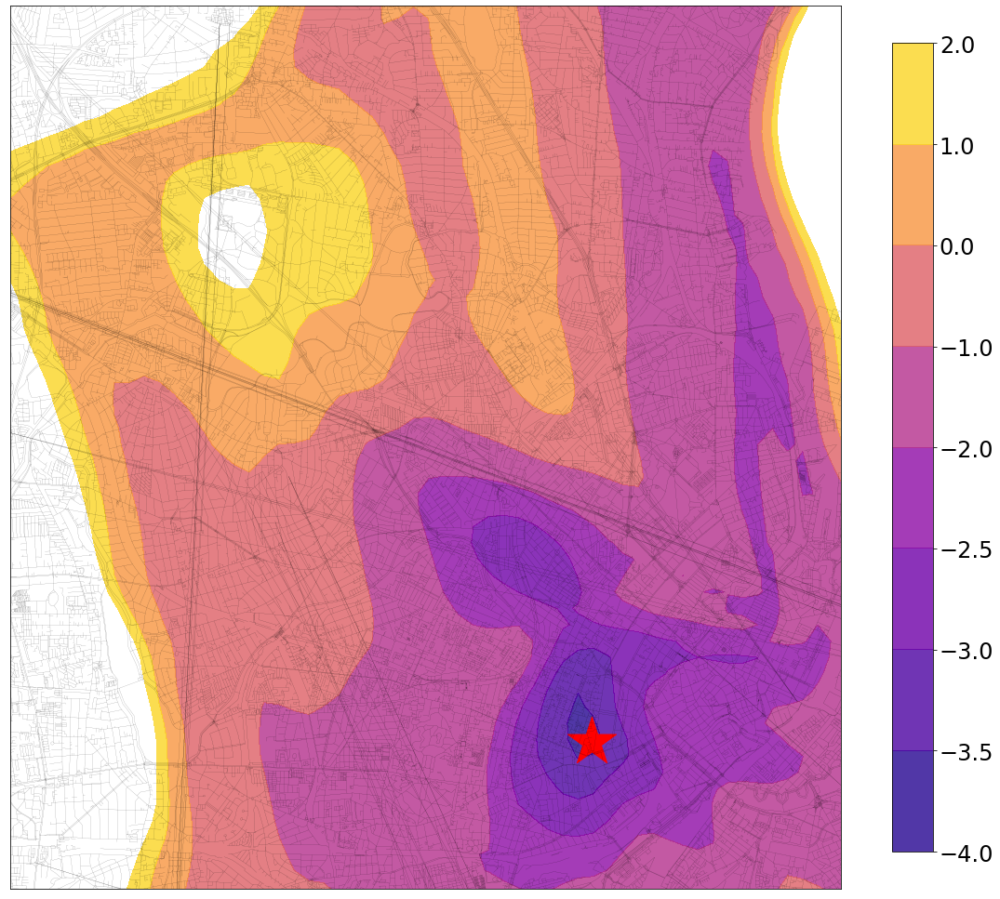

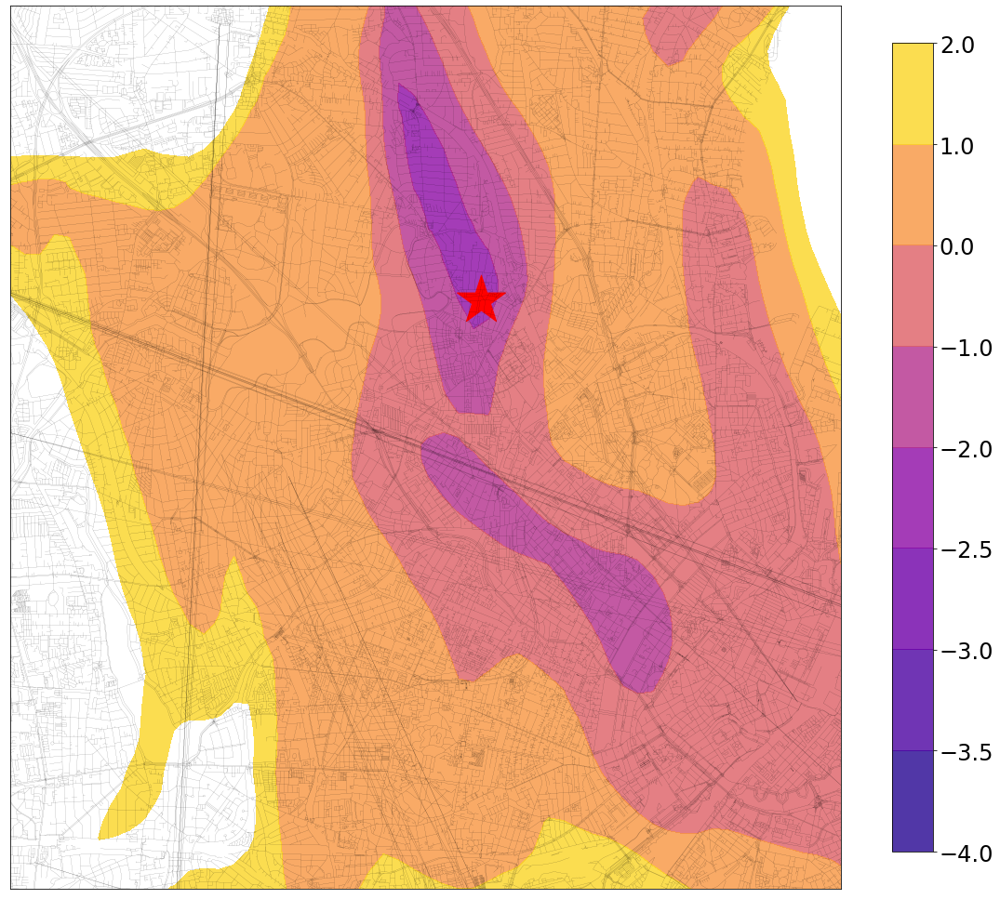

In [ ]:
net_pickup.eval()
start_positions = [
    (12.59, 55.67),
    (12.555, 55.675),
    (12.535, 55.72),
    (12.59, 55.67)
]
levels = [
    [-4, -3.5, -3, -2.5, -2, -1, 0, 1, 2],
    [-4, -3.5, -3, -2.5, -2, -1, 0, 1, 2],
    [-4, -3.5, -3, -2.5, -2, -1, 0, 1, 2],
    [-4, -3.5, -3, -2.5, -2, -1, 0, 1, 2]
]

for i in range(3):
    start_position = start_positions[i]

    start_position_lng_encoded = (start_position[0]  - mu_lng_start) / sig_lng_start
    start_position_lat_encoded = (start_position[1] - mu_lat_start) / sig_lat_start
    cond_pickup = torch.Tensor([start_position_lng_encoded, start_position_lat_encoded])

    X, Y, Z = Z_values(net_pickup.log_likelihood, (minx, maxx, miny, maxy), mu_lng_end, sig_lng_end, mu_lat_end, sig_lat_end, cond=cond_pickup)

    map_plot = city_map.plot(figsize=(20, 20), edgecolor='black', linewidth=0.1)

    CS = map_plot.contourf(
        X, 
        Y, 
        Z, 
        cmap='plasma',
        levels=levels[i],
        alpha=0.8,
    )

    CB = plt.colorbar(CS, shrink=0.8, extend='both')
    CB.ax.tick_params(labelsize=24)

    map_plot.scatter(start_position[0], start_position[1], s=3000, marker='*', c='red')

    map_plot.set_xlim(plotting_bounds[0], plotting_bounds[1])
    map_plot.set_ylim(plotting_bounds[2], plotting_bounds[3])

    map_plot.set_title('')
    map_plot.set_xticks([])
    map_plot.set_yticks([])
    map_plot.set_title('')
    plt.savefig(f'POSTER/pickup{i}_cond.png', transparent=True, bbox_inches='tight')

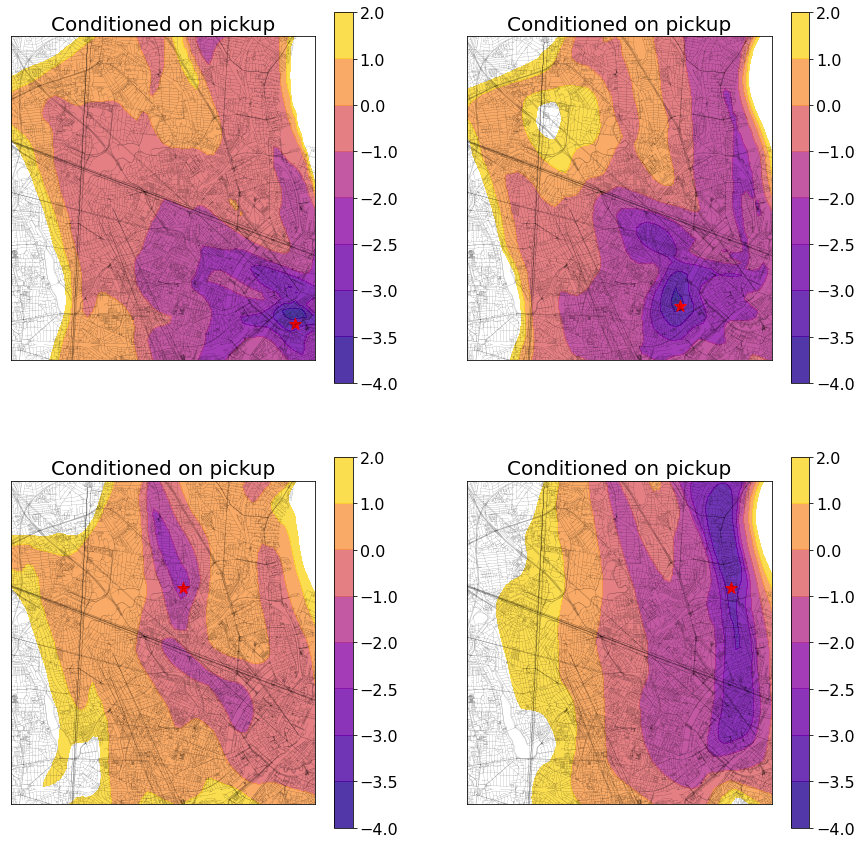

In [ ]:



fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(15,15))


for i, ax in enumerate(axes.flat):
    start_position = start_positions[i]

    start_position_lng_encoded = (start_position[0]  - mu_lng_start) / sig_lng_start
    start_position_lat_encoded = (start_position[1] - mu_lat_start) / sig_lat_start
    cond_pickup = torch.Tensor([start_position_lng_encoded, start_position_lat_encoded])

    X, Y, Z = Z_values(net_pickup.log_likelihood, (minx, maxx, miny, maxy), mu_lng_end, sig_lng_end, mu_lat_end, sig_lat_end, cond=cond_pickup)

    map_plot = city_map.plot(figsize=(20, 20), edgecolor='black', linewidth=0.1, ax=ax)

    CS = ax.contourf(
        X, 
        Y, 
        Z, 
        cmap='plasma',
        levels=levels[i],
        alpha=0.8,
    )
    CB = fig.colorbar(CS, ax=ax)

    CB.ax.tick_params(labelsize=16)
    
    #x, y = df_sub_time['startPositionLng'].values, df_sub_time['startPositionLat'].values
    #scatter = map_plot.scatter(x, y, marker="*", c='black', zorder=5, s=1)
    map_plot.scatter(start_position[0], start_position[1], s=150, marker='*', c='red')

    ax.set_xticks([])
    ax.set_yticks([])
    
    ax.set_xlim(plotting_bounds[0], plotting_bounds[1])
    ax.set_ylim(plotting_bounds[2], plotting_bounds[3])
    ax.set_title(f'Conditioned on pickup', fontdict={'size': 20})

## LOG PROB

In [ ]:
x_log = torch.Tensor(data[['NormLngStart', 'NormLatStart', 'NormLngEnd', 'NormLatEnd']].values)
x, log_det = net_pickup.forward(x_log)
prior_logprob = net_pickup.prior.log_prob(x)
-(prior_logprob.sum() + log_det.sum())

tensor(-585404.8750, grad_fn=<NegBackward>)

In [ ]:
X, Y, Z = Z_values(net_pickup.log_likelihood, (minx, maxx, miny, maxy), mu_lng_end, sig_lng_end, mu_lat_end, sig_lat_end, cond=cond_pickup)

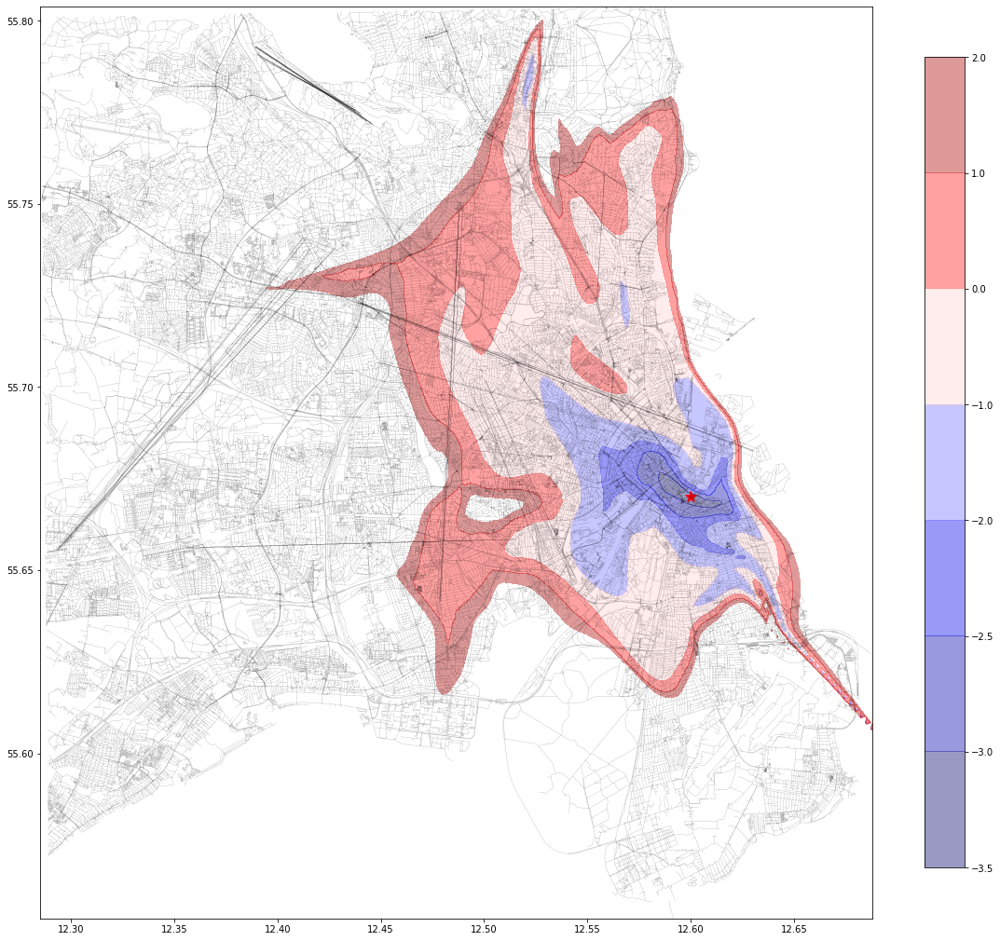

In [ ]:
map_plot = city_map.plot(figsize=(20, 20), edgecolor='black', linewidth=0.1)
map_plot = contour_plot_map(
    map_plot, 
    X,
    Y,
    Z,
    cmap='seismic',
    levels=[-3.5, -3, -2.5, -2, -1, 0, 1, 2],
    alpha=0.4
)
map_plot.scatter(start_position[0], start_position[1], s=150, marker='*', c='red')

In [ ]:
mu = torch.zeros(4).to(device)
sigma = torch.ones(4).to(device)
base = Normal(mu, sigma)

net_pickup = RealNVP(in_features=4, prior=base, hidden_features=128, depth=10, batchnorm=True).to(device)

In [ ]:
net_pickup.load_state_dict(torch.load('model_state_pickup_fix_prior_cond_BN.pth'))

<All keys matched successfully>

In [ ]:
start_position= (12.60, 55.67)
start_position_lng_encoded = (start_position[0]  - mu_lng_start) / sig_lng_start
start_position_lat_encoded = (start_position[1] - mu_lat_start) / sig_lat_start
cond_pickup = torch.Tensor([start_position_lng_encoded, start_position_lat_encoded])

In [ ]:
net_pickup.eval()
X, Y, Z = Z_values(net_pickup.log_likelihood, (minx, maxx, miny, maxy), mu_lng_end, sig_lng_end, mu_lat_end, sig_lat_end, cond=cond_pickup)

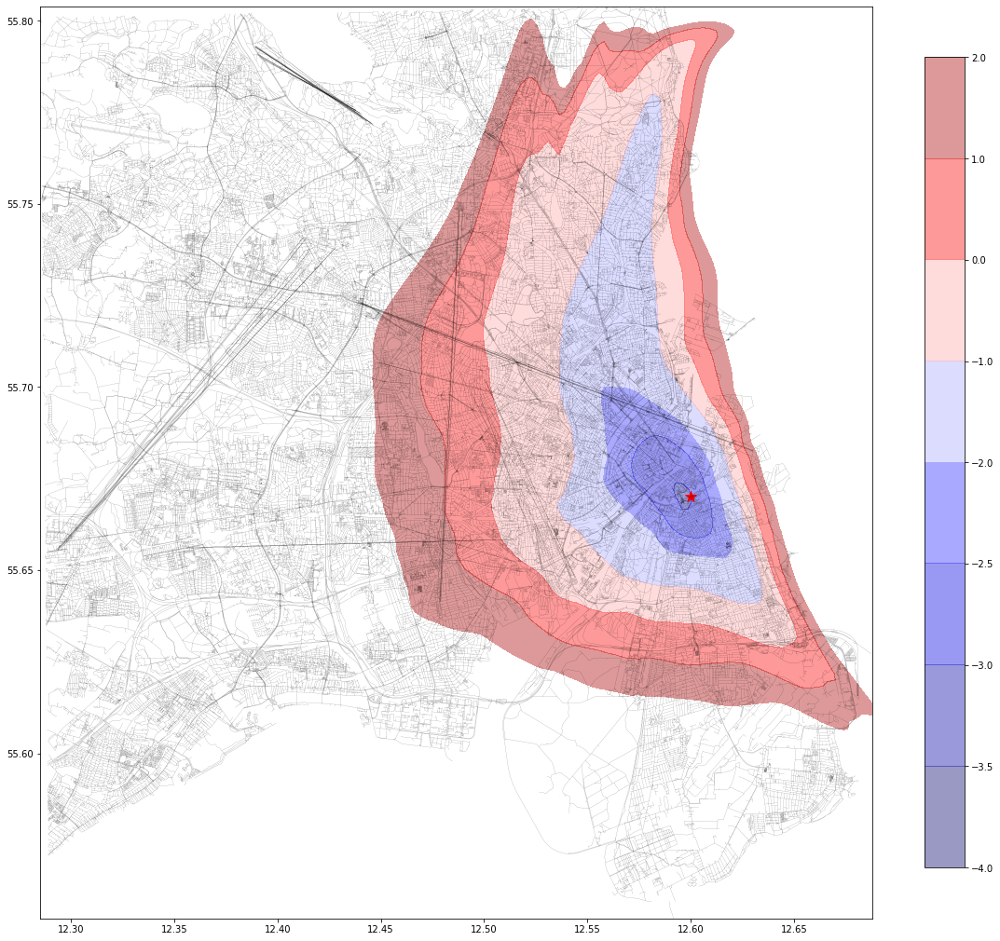

In [ ]:
map_plot = city_map.plot(figsize=(20, 20), edgecolor='black', linewidth=0.1)
map_plot = contour_plot_map(
    map_plot, 
    X,
    Y,
    Z,
    cmap='seismic',
    levels=[-4, -3.5, -3, -2.5, -2, -1, 0, 1, 2],
    alpha=0.4
)
map_plot.scatter(start_position[0], start_position[1], s=150, marker='*', c='red')

In [ ]:
a